&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;<img src="../DATA/corp_logo.jpg" width='160'>

# Blurring and Smoothing

Smoothing an image can help to get rid of noise, or help an application to focus on general details. There are many methods of bluring and smoothing.

Often blurring or smoothing combined with edge detection. Edge detection algorithms detect too much edges in the case of feeding a high resolution non-blurring image to them.

<img src="./images/blurring.png" width= "700">

# Methods Will Be Explored

- **Gamma Correction:** Can be applied to an image to make it appear brighter or darker depending on the camera value chosen.
- **Kernel Based Filter:** For producing a variety of effects. Check this link for interactive vislualization: http://setosa.io/ev/image-kernels

--- 

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [3]:
def load_img():
    img = cv2.imread('../DATA/bricks.jpg')
    img = cv2.resize(img, (900, 700))
    #valid range for float input is [0..1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32) / 255
    return img

def display_img(img):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(111)
    ax.imshow(img)

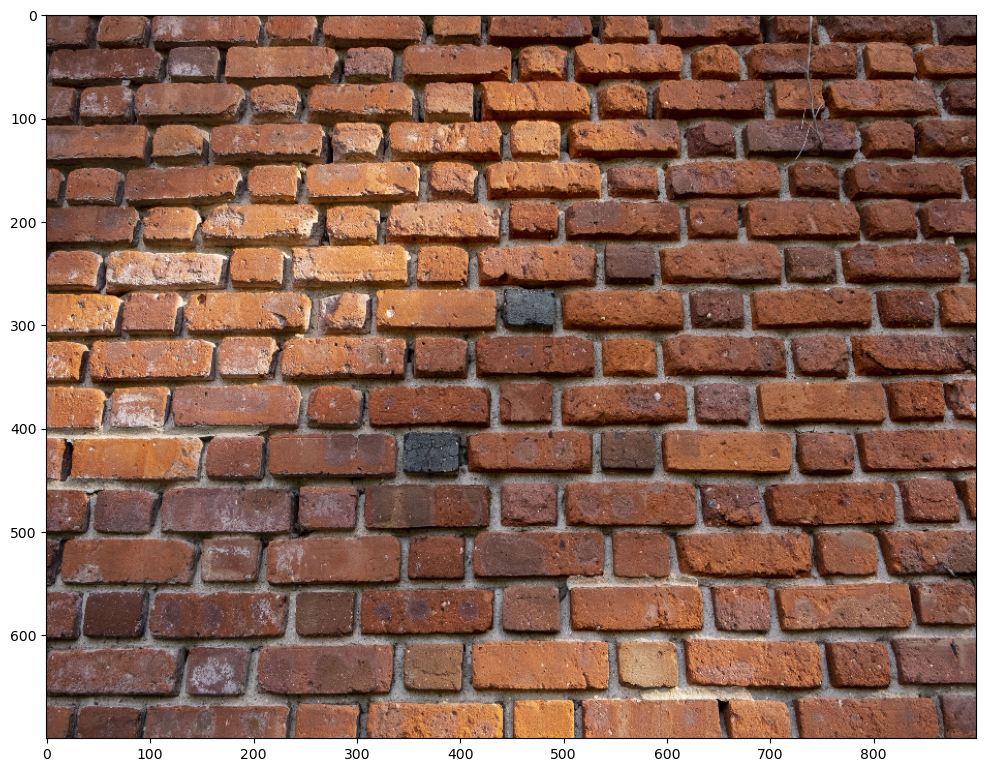

In [4]:
i = load_img()
display_img(i)

### Gamma Correction
increasing and decreasing brightness

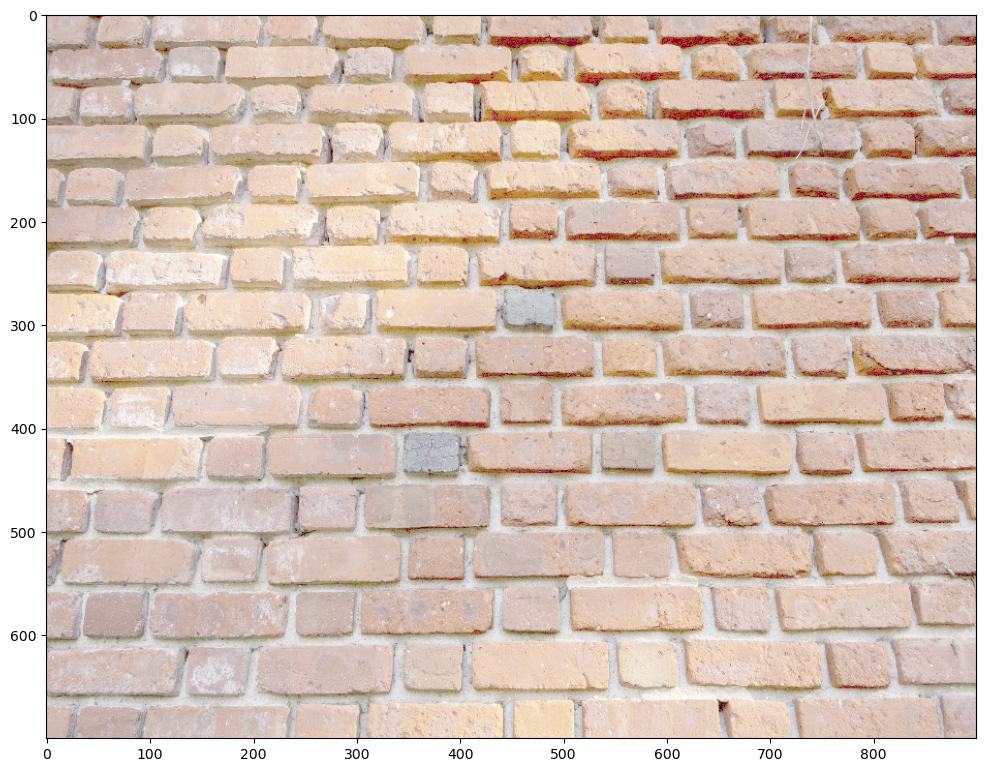

In [5]:
# Increasing brightness
img = load_img()
gamma = 1/4
effected_image = np.power(img, gamma)
display_img(effected_image)

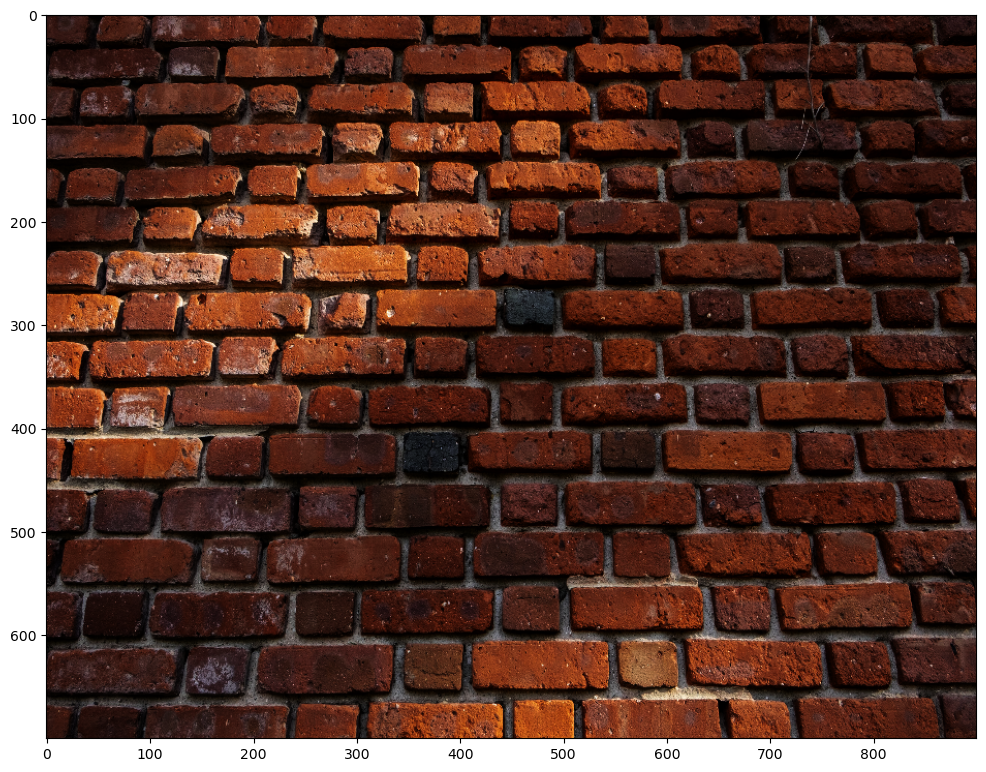

In [6]:
# Decreasing brightness
img = load_img()
gamma = 2
effected_image = np.power(img, gamma)
display_img(effected_image)

### Low-Pass Filter with a 2D Convolution

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


<function print>

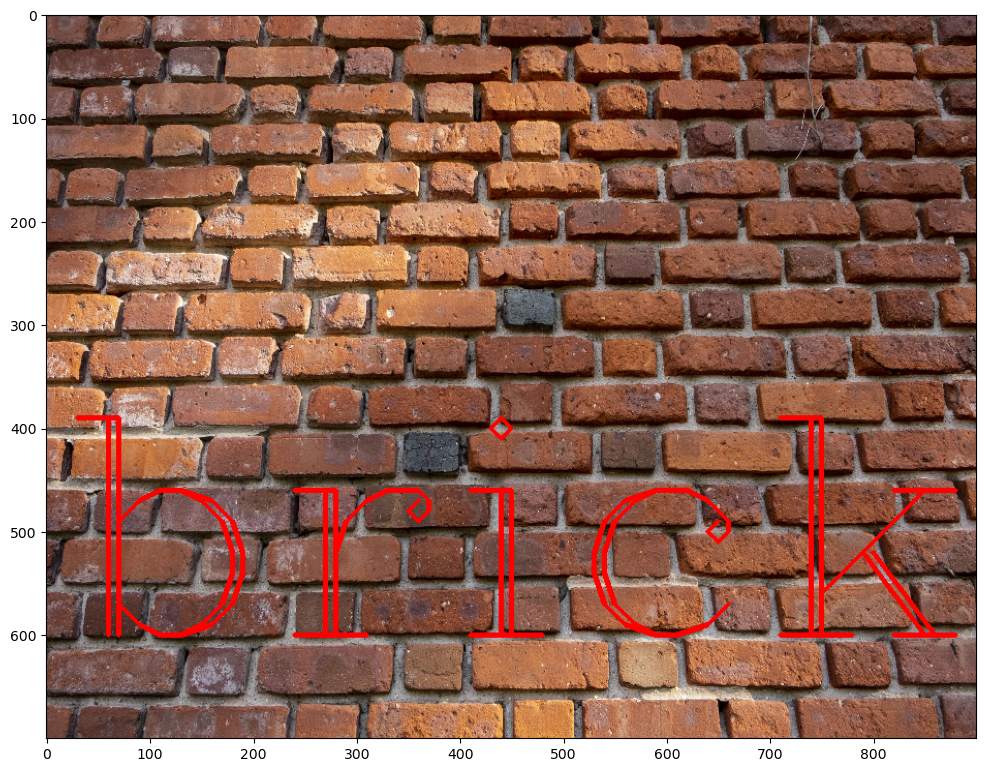

In [11]:
# Write something on the original image
# Warning 
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='brick',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)
print

In [12]:
# Create the kernel
kernel = np.ones(shape=(5,5),dtype=np.float32) / 25
kernel

array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


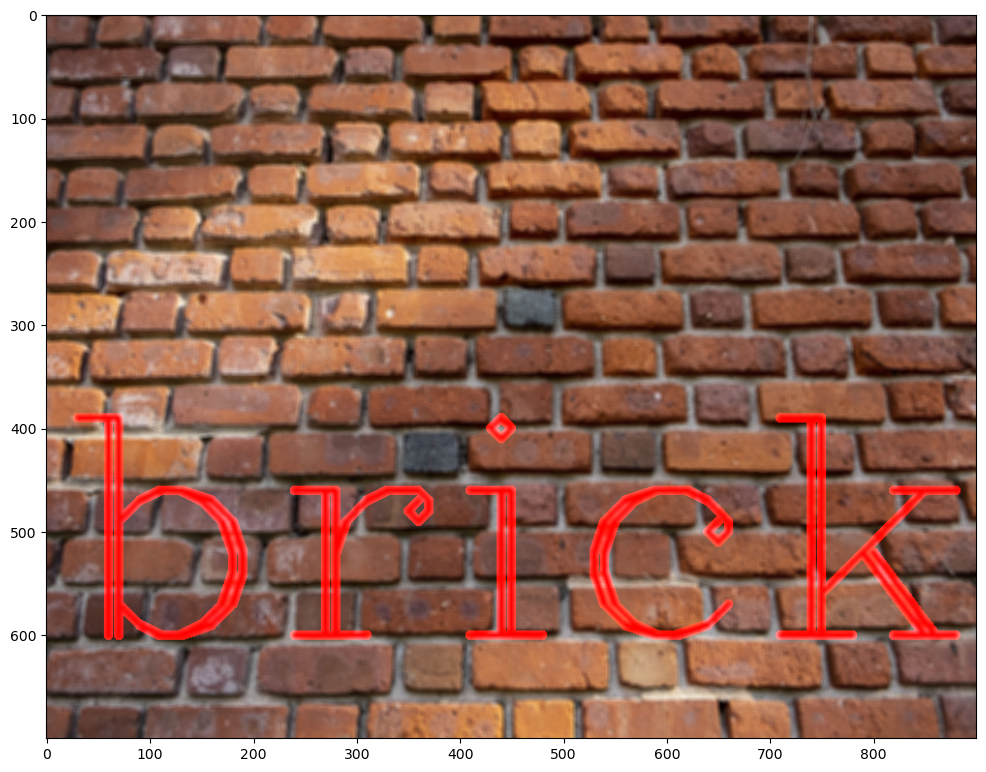

In [13]:
dst = cv2.filter2D(img,-1,kernel)
display_img(dst)

**Note:** the `-1` element in the `cv2.filter2D(img,-1,kernel)` refers to the desired depth of the destination image. Check this [link](https://stackoverflow.com/questions/43392956/explanation-for-ddepth-parameter-in-cv2-filter2d-opencv#:~:text=You%20can%20see%20in%20the,the%20input%20(source)%20image.&text=uses%20depth()%20function%20which,transformed%20by%20a%20rigid%20transform.)_ for more information

Later on, the mothods mainly utilized for **removing noise** from an image.
### Averaging

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


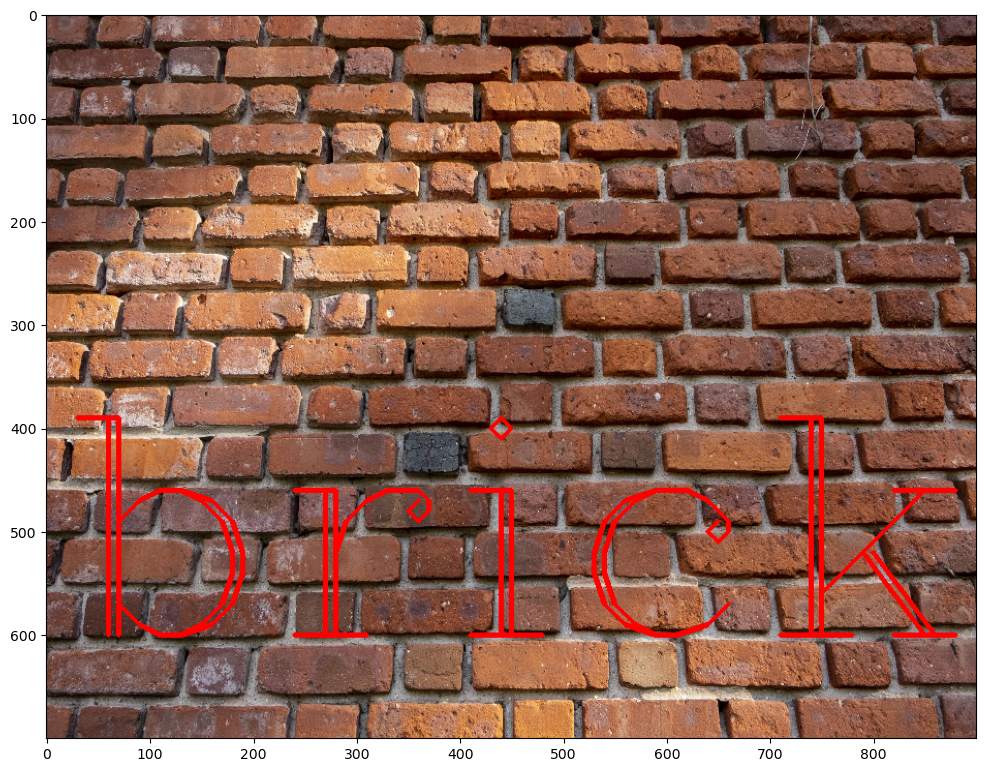

In [14]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


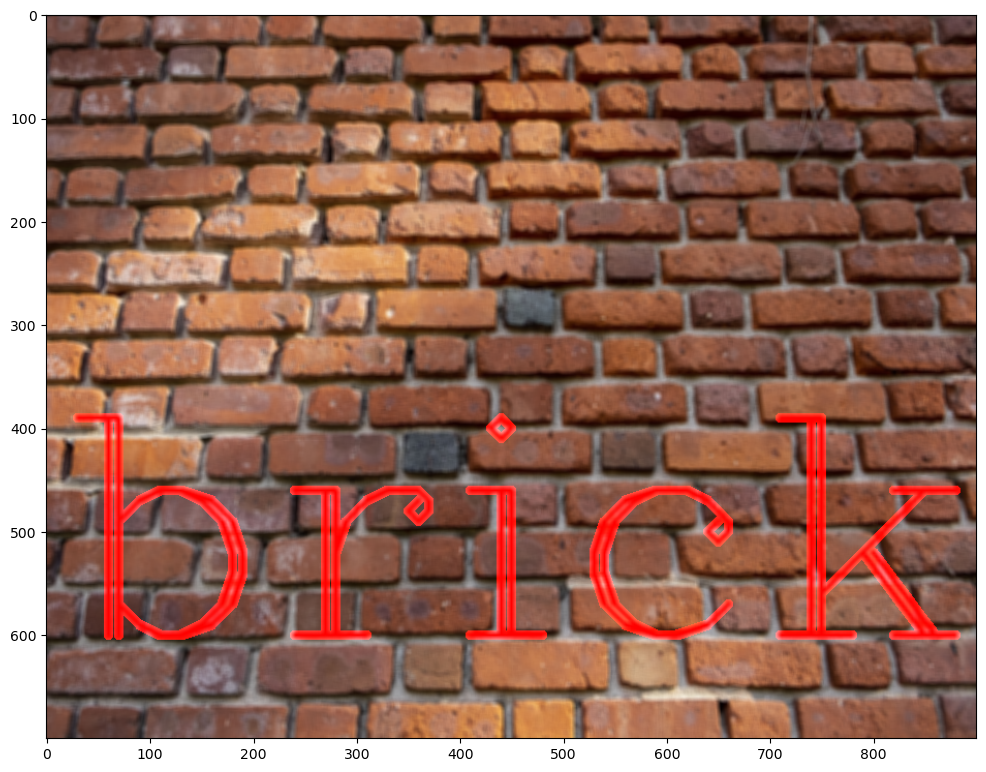

In [15]:
blurred_img = cv2.blur(img,ksize=(5,5))
display_img(blurred_img)

### Gaussian Blurring

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


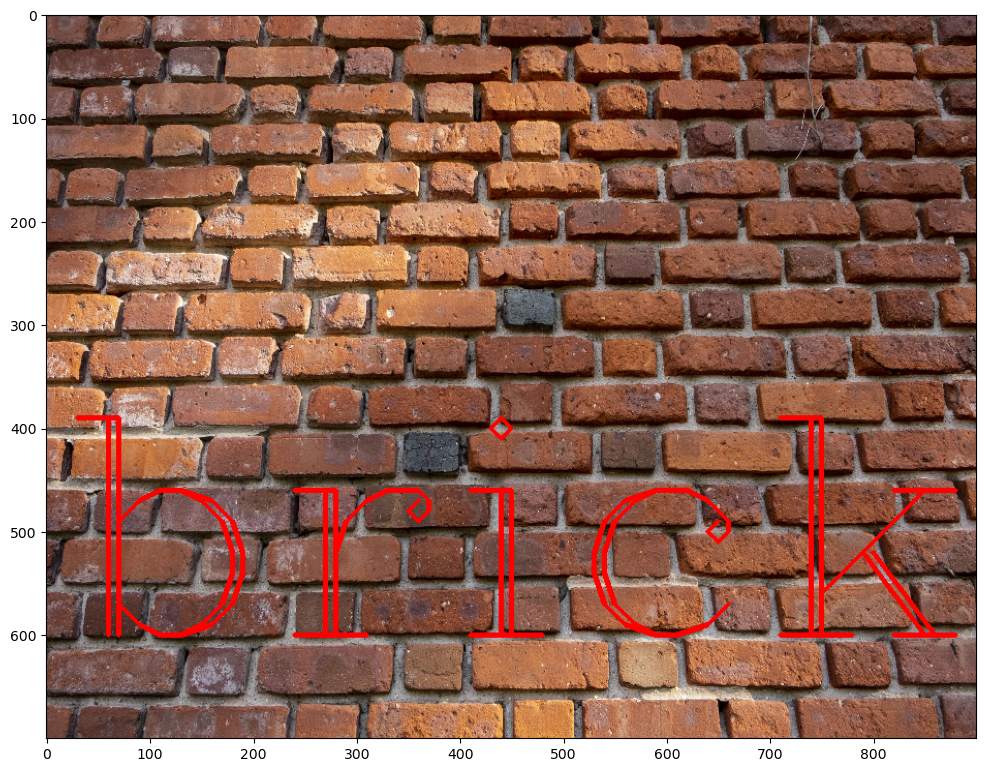

In [16]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


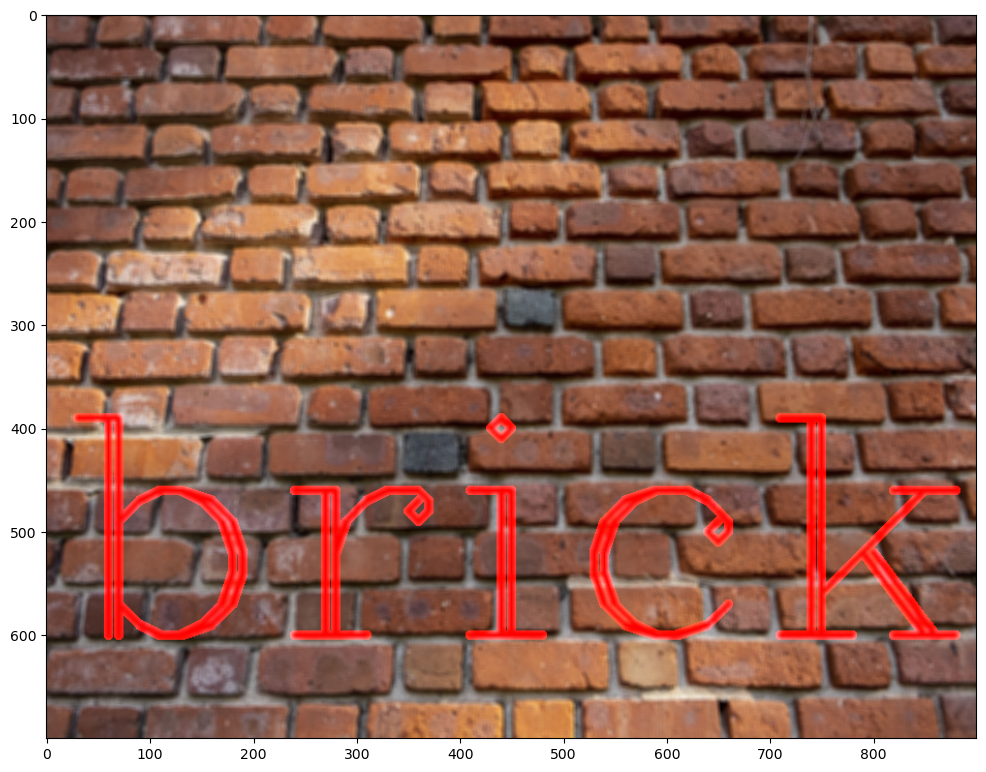

In [17]:
blurred_img = cv2.GaussianBlur(img,(5,5),10)
display_img(blurred_img)

### Median Blurring

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


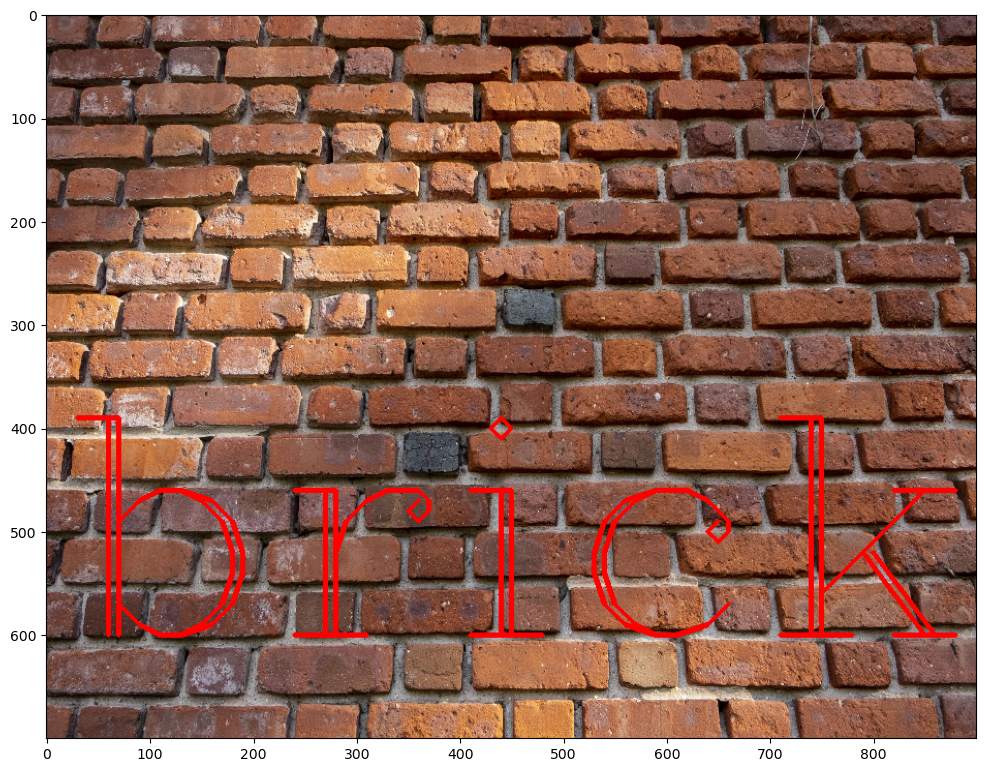

In [18]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


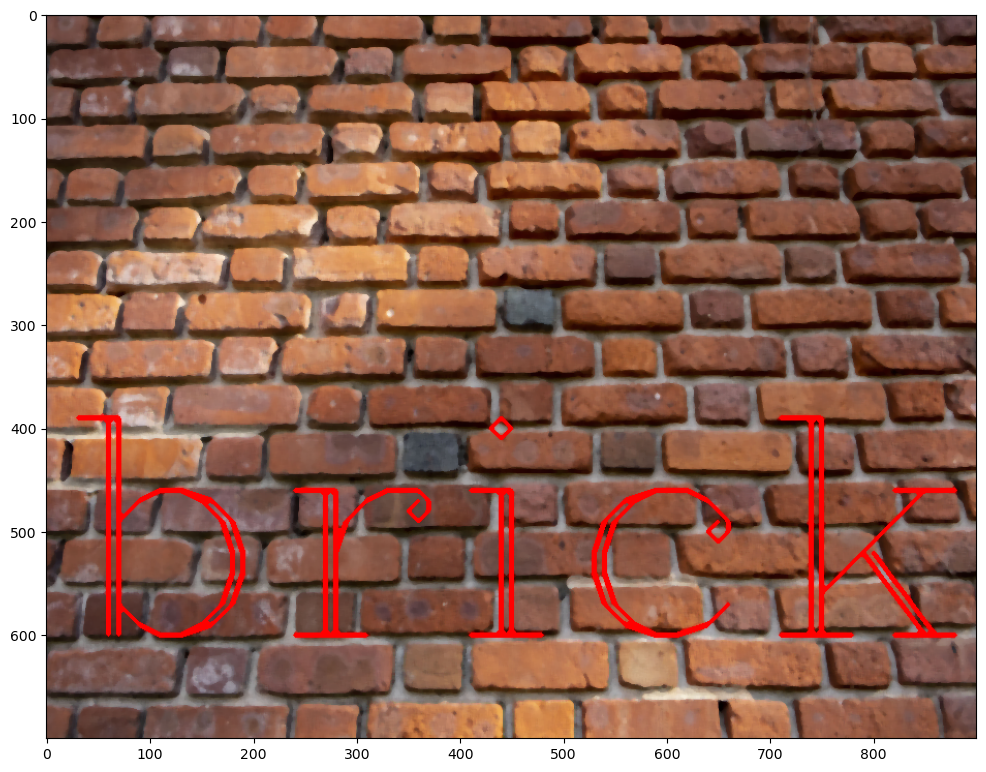

In [19]:
median = cv2.medianBlur(img,5)
display_img(median)

--- 
### Adding noise

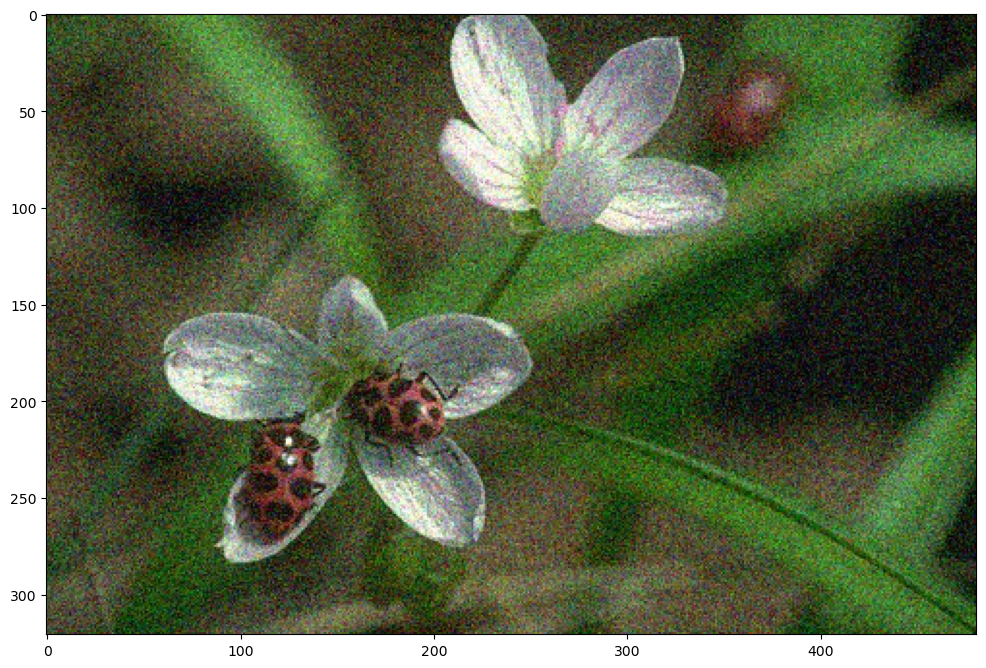

In [27]:
img = cv2.imread('../DATA/noisy_flower.jpg')
noisy_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
display_img(noisy_img)

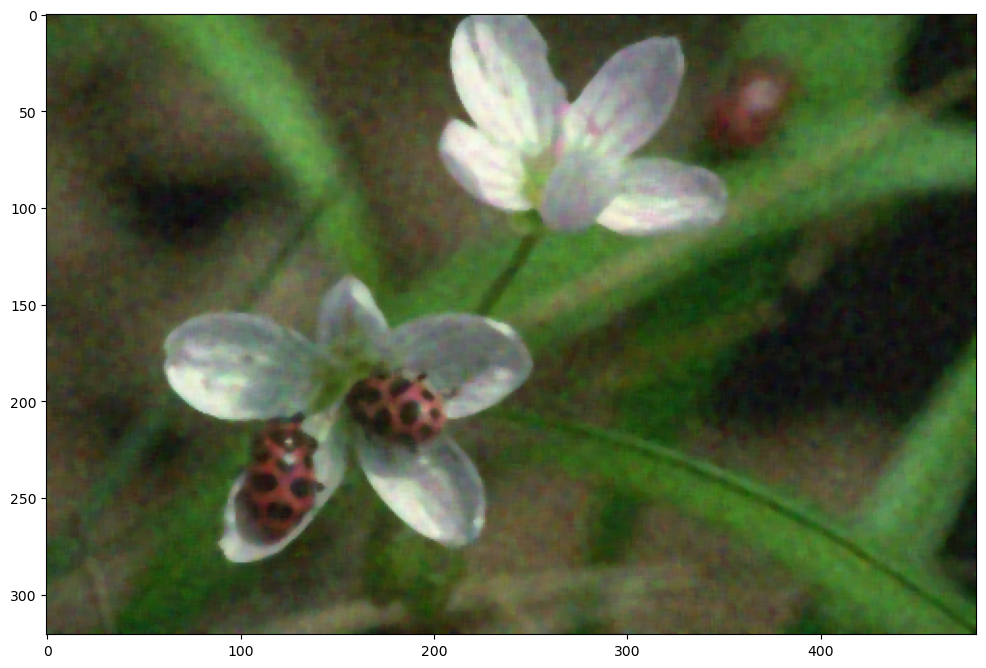

In [28]:
median = cv2.medianBlur(noisy_img,5)
display_img(median)

As you see, there is less noise in the second image, but more details have been lost.

### Bilateral Filtering
It is trying to reduce unwanted noise and keep edges fairly sharp. However, It is usually **slower** compared to other filters.

Check the [link](http://www.dai.ed.ac.uk/CVonline/LOCAL_COPIES/MANDUCHI1/Bilateral_Filtering.html) for more details.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


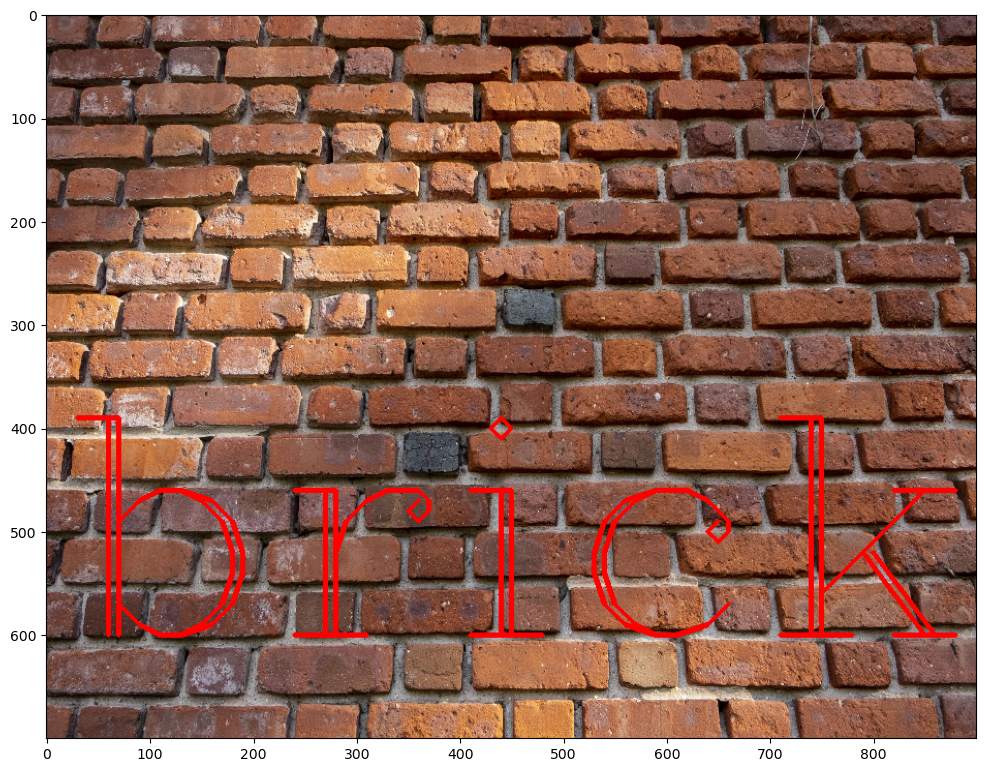

In [29]:
img = load_img()
font = cv2.FONT_HERSHEY_COMPLEX
cv2.putText(img,text='bricks',org=(10,600), fontFace=font,fontScale= 10,color=(255,0,0),thickness=4)
display_img(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


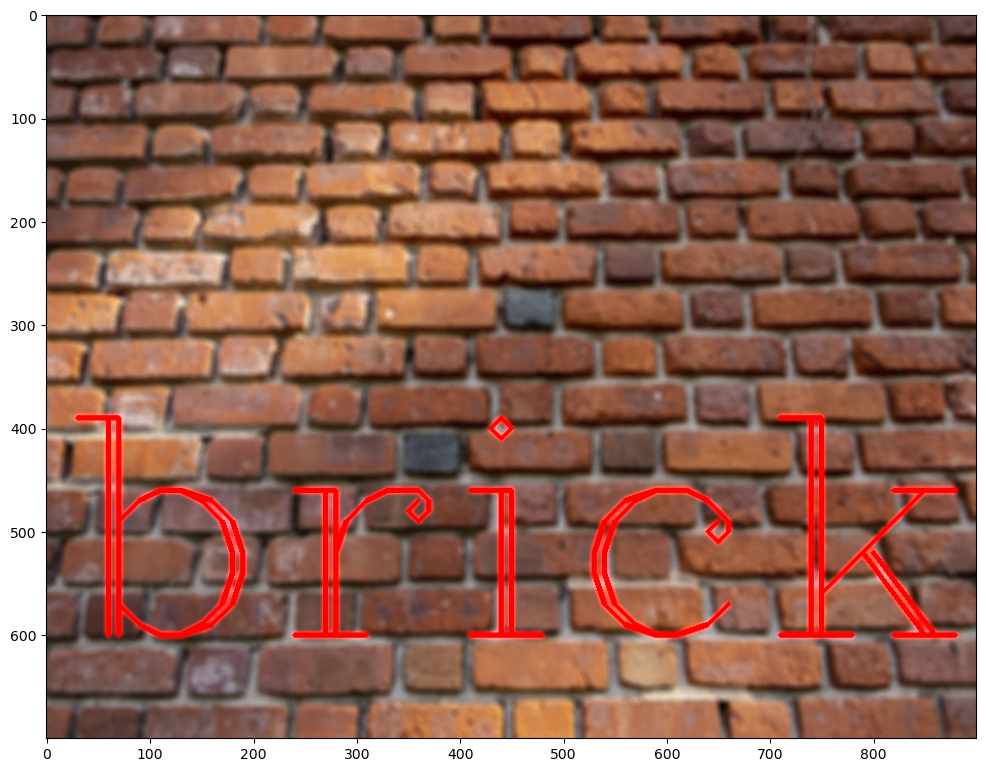

In [30]:
blur = cv2.bilateralFilter(img,9,75,75)
display_img(blur)